In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import gaussian_kde

import plotly
import plotly.graph_objs as go
from plotly import tools
import plotly.figure_factory as ff

##############  OFFLINE  ##############
plotly.offline.init_notebook_mode(connected=True)
#to plot offline: ##plotly.offline.iplot##

##############  ONLINE  ##############
#plotly.tools.set_credentials_file(username='arnaurovira23', api_key='7y46ugRJ8Rl6XCkCwBGM')
#to plot online: ##py.iplot##
import plotly.plotly as py


# LOAD DATA

###### train dataset

In [2]:
#Load train dataset
df_train = pd.read_csv('data/train.csv')
df_train.head()

,Id,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,...,Soil_Type32,Soil_Type33,Soil_Type34,Soil_Type35,Soil_Type36,Soil_Type37,Soil_Type38,Soil_Type39,Soil_Type40,Cover_Type
0,1,2596,51,3,258,0,510,221,232,148,...,0,0,0,0,0,0,0,0,0,5
1,2,2590,56,2,212,-6,390,220,235,151,...,0,0,0,0,0,0,0,0,0,5
2,3,2804,139,9,268,65,3180,234,238,135,...,0,0,0,0,0,0,0,0,0,2
3,4,2785,155,18,242,118,3090,238,238,122,...,0,0,0,0,0,0,0,0,0,2
4,5,2595,45,2,153,-1,391,220,234,150,...,0,0,0,0,0,0,0,0,0,5


In [3]:
df_train.describe()

,Id,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,...,Soil_Type32,Soil_Type33,Soil_Type34,Soil_Type35,Soil_Type36,Soil_Type37,Soil_Type38,Soil_Type39,Soil_Type40,Cover_Type
count,15120.00000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,...,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000,15120.000000
mean,7560.50000,2749.322553,156.676653,16.501587,227.195701,51.076521,1714.023214,212.704299,218.965608,135.091997,...,0.045635,0.040741,0.001455,0.006746,0.000661,0.002249,0.048148,0.043452,0.030357,4.000000
std,4364.91237,417.678187,110.085801,8.453927,210.075296,61.239406,1325.066358,30.561287,22.801966,45.895189,...,0.208699,0.197696,0.038118,0.081859,0.025710,0.047368,0.214086,0.203880,0.171574,2.000066
min,1.00000,1863.000000,0.000000,0.000000,0.000000,-146.000000,0.000000,0.000000,99.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000
25%,3780.75000,2376.000000,65.000000,10.000000,67.000000,5.000000,764.000000,196.000000,207.000000,106.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000
50%,7560.50000,2752.000000,126.000000,15.000000,180.000000,32.000000,1316.000000,220.000000,223.000000,138.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.000000
75%,11340.25000,3104.000000,261.000000,22.000000,330.000000,79.000000,2270.000000,235.000000,235.000000,167.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,6.000000
max,15120.00000,3849.000000,360.000000,52.000000,1343.000000,554.000000,6890.000000,254.000000,254.000000,248.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,7.000000


In [4]:
#Shape of train dataset
num_train = df_train.shape[0]
print(num_train)

15120


In [5]:
features_all = df_train.drop(columns='Id').columns.tolist()
print(features_all)

['Elevation', 'Aspect', 'Slope', 'Horizontal_Distance_To_Hydrology', 'Vertical_Distance_To_Hydrology', 'Horizontal_Distance_To_Roadways', 'Hillshade_9am', 'Hillshade_Noon', 'Hillshade_3pm', 'Horizontal_Distance_To_Fire_Points', 'Wilderness_Area1', 'Wilderness_Area2', 'Wilderness_Area3', 'Wilderness_Area4', 'Soil_Type1', 'Soil_Type2', 'Soil_Type3', 'Soil_Type4', 'Soil_Type5', 'Soil_Type6', 'Soil_Type7', 'Soil_Type8', 'Soil_Type9', 'Soil_Type10', 'Soil_Type11', 'Soil_Type12', 'Soil_Type13', 'Soil_Type14', 'Soil_Type15', 'Soil_Type16', 'Soil_Type17', 'Soil_Type18', 'Soil_Type19', 'Soil_Type20', 'Soil_Type21', 'Soil_Type22', 'Soil_Type23', 'Soil_Type24', 'Soil_Type25', 'Soil_Type26', 'Soil_Type27', 'Soil_Type28', 'Soil_Type29', 'Soil_Type30', 'Soil_Type31', 'Soil_Type32', 'Soil_Type33', 'Soil_Type34', 'Soil_Type35', 'Soil_Type36', 'Soil_Type37', 'Soil_Type38', 'Soil_Type39', 'Soil_Type40', 'Cover_Type']


In [6]:
feat_soils = [feat for feat in features_all if 'Soil' in feat]
feat_wild = [feat for feat in features_all if 'Wilderness' in feat]
feat_num = [feat for feat in features_all if ('Wilderness' not in feat) & ('Soil' not in feat) & ('Cover' not in feat)]


In [7]:
df_train.isnull().sum().sum()
print(f"How many NaN values are in df_train dataset? {df_train.isnull().sum().sum()}")

How many NaN values are in df_train dataset? 0


In [8]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15120 entries, 0 to 15119
Data columns (total 56 columns):
Id                                    15120 non-null int64
Elevation                             15120 non-null int64
Aspect                                15120 non-null int64
Slope                                 15120 non-null int64
Horizontal_Distance_To_Hydrology      15120 non-null int64
Vertical_Distance_To_Hydrology        15120 non-null int64
Horizontal_Distance_To_Roadways       15120 non-null int64
Hillshade_9am                         15120 non-null int64
Hillshade_Noon                        15120 non-null int64
Hillshade_3pm                         15120 non-null int64
Horizontal_Distance_To_Fire_Points    15120 non-null int64
Wilderness_Area1                      15120 non-null int64
Wilderness_Area2                      15120 non-null int64
Wilderness_Area3                      15120 non-null int64
Wilderness_Area4                      15120 non-null int64
Soil_T

Since the soil and wilderness type features are dummy categorical variables and the cover type are labels, we use uint8

In [9]:
df_train[feat_wild]=df_train[feat_wild].astype('uint8')
df_train[feat_soils]=df_train[feat_soils].astype('uint8')
df_train['Cover_Type']=df_train['Cover_Type'].astype('uint8')

In [10]:
df_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 15120 entries, 0 to 15119
Data columns (total 56 columns):
Id                                    15120 non-null int64
Elevation                             15120 non-null int64
Aspect                                15120 non-null int64
Slope                                 15120 non-null int64
Horizontal_Distance_To_Hydrology      15120 non-null int64
Vertical_Distance_To_Hydrology        15120 non-null int64
Horizontal_Distance_To_Roadways       15120 non-null int64
Hillshade_9am                         15120 non-null int64
Hillshade_Noon                        15120 non-null int64
Hillshade_3pm                         15120 non-null int64
Horizontal_Distance_To_Fire_Points    15120 non-null int64
Wilderness_Area1                      15120 non-null uint8
Wilderness_Area2                      15120 non-null uint8
Wilderness_Area3                      15120 non-null uint8
Wilderness_Area4                      15120 non-null uint8
Soil_T

###### test dataset

In [11]:
#Load test dataset
df_test = pd.read_csv('data/test.csv')
df_test.head()

,Id,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,...,Soil_Type31,Soil_Type32,Soil_Type33,Soil_Type34,Soil_Type35,Soil_Type36,Soil_Type37,Soil_Type38,Soil_Type39,Soil_Type40
0,15121,2680,354,14,0,0,2684,196,214,156,...,0,0,0,0,0,0,0,0,0,0
1,15122,2683,0,13,0,0,2654,201,216,152,...,0,0,0,0,0,0,0,0,0,0
2,15123,2713,16,15,0,0,2980,206,208,137,...,0,0,0,0,0,0,0,0,0,0
3,15124,2709,24,17,0,0,2950,208,201,125,...,0,0,0,0,0,0,0,0,0,0
4,15125,2706,29,19,0,0,2920,210,195,115,...,0,0,0,0,0,0,0,0,0,0


In [12]:
df_test.describe()

,Id,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,...,Soil_Type31,Soil_Type32,Soil_Type33,Soil_Type34,Soil_Type35,Soil_Type36,Soil_Type37,Soil_Type38,Soil_Type39,Soil_Type40
count,565892.000000,565892.000000,565892.000000,565892.000000,565892.000000,565892.000000,565892.000000,565892.000000,565892.000000,565892.000000,...,565892.000000,565892.000000,565892.000000,565892.000000,565892.000000,565892.000000,565892.000000,565892.000000,565892.000000,565892.000000
mean,298066.500000,2964.977407,155.629558,14.039635,270.556622,46.294408,2367.143116,212.131133,223.435026,142.726951,...,0.044768,0.091588,0.078704,0.002808,0.003161,0.000193,0.000467,0.026233,0.023236,0.014651
std,163359.093603,273.157030,111.962120,7.450155,212.500153,58.209469,1561.482002,26.661063,19.668053,38.030094,...,0.206795,0.288444,0.269277,0.052916,0.056137,0.013877,0.021594,0.159827,0.150652,0.120152
min,15121.000000,1859.000000,0.000000,0.000000,0.000000,-173.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,156593.750000,2818.000000,58.000000,9.000000,108.000000,7.000000,1116.000000,198.000000,213.000000,119.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,298066.500000,2999.000000,127.000000,13.000000,228.000000,29.000000,2018.000000,218.000000,226.000000,143.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,439539.250000,3164.000000,260.000000,18.000000,390.000000,69.000000,3349.000000,231.000000,237.000000,168.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,581012.000000,3858.000000,360.000000,66.000000,1397.000000,601.000000,7117.000000,254.000000,254.000000,254.000000,...,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000


In [13]:
df_test.isnull().sum().sum()
print(f"How many NaN values are in df_train dataset? {df_test.isnull().sum().sum()}")

How many NaN values are in df_train dataset? 0


In [14]:
df_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 565892 entries, 0 to 565891
Data columns (total 55 columns):
Id                                    565892 non-null int64
Elevation                             565892 non-null int64
Aspect                                565892 non-null int64
Slope                                 565892 non-null int64
Horizontal_Distance_To_Hydrology      565892 non-null int64
Vertical_Distance_To_Hydrology        565892 non-null int64
Horizontal_Distance_To_Roadways       565892 non-null int64
Hillshade_9am                         565892 non-null int64
Hillshade_Noon                        565892 non-null int64
Hillshade_3pm                         565892 non-null int64
Horizontal_Distance_To_Fire_Points    565892 non-null int64
Wilderness_Area1                      565892 non-null int64
Wilderness_Area2                      565892 non-null int64
Wilderness_Area3                      565892 non-null int64
Wilderness_Area4                      565892 non-

In [15]:
#Shape of test dataset
num_test = df_test.shape[0]
print(num_test)

565892


In [16]:
df_test[feat_wild]=df_test[feat_wild].astype('uint8')
df_test[feat_soils]=df_test[feat_soils].astype('uint8')


# EXPLORATORY DATA ANALYSIS
#### Analyze class balance

In [17]:
#count number of Cover_Type == TARGET on train dataset
df_train['Cover_Type'].value_counts()
covertypes = np.sort(df_train['Cover_Type'].unique())


Each target has 2160 observations

### Visualize histogram of feature hued by cover type

In [18]:
#plot the Elevetion frequency with seaborn for each Target

# fig = plt.figure(figsize=(10,8))
# title = fig.suptitle("Elevation distribution", fontsize=14)
# fig.subplots_adjust(top=0.93, wspace=0.3)
# sns.set_style("ticks")

# ax = fig.add_subplot(1,1,1)
# ax.set_xlabel("Elevation")
# ax.set_ylabel("Frequency") 

# g = sns.FacetGrid(data=df_train[['Cover_Type','Elevation']], hue='Cover_Type')

# g.map(sns.distplot, 'Elevation', kde=True, bins=15, ax=ax)

# ax.legend(title='Cover_type')
# plt.close(2)

In [19]:
#plot histogram of Elevation for each target with plot.ly

# trace = []
# for i in range(1,len(df_train['Cover_Type'].unique())+1):
#     trace.append(go.Histogram(x=df_train[df_train['Cover_Type']==i]['Elevation'],opacity=0.75))

# layout = go.Layout(barmode='overlay')

# fig = go.Figure(data=trace, layout=layout)

# plotly.offline.iplot(fig)

In [20]:
feature = 'Slope'
trace = []
group_labels = []

for i in np.sort(df_train['Cover_Type'].unique())[::-1]:
    trace.append(df_train[df_train['Cover_Type']==i][feature])
    group_labels.append(f"Cover type {int(i)}")

fig = ff.create_distplot(trace, group_labels, bin_size=10, show_rug = True)
fig['layout'].update(title=f"Hist and Dist of {feature}")

# Plot!
plotly.offline.iplot(fig, filename='Distplot with Multiple Datasets')

### Visualize histogram of all features in a given cover type

In [21]:
trace = []
name = []

features = df_train.columns.tolist()[1:11]
#number of desired cover type or -1 for all cover types
cover_type = -1
for i, feat in enumerate(features):
    if cover_type > 0:
        trace.append(go.Histogram(x = df_train.loc[df_train['Cover_Type']==cover_type,feat],nbinsx=30))
    else:
        trace.append(go.Histogram(x = df_train[feat],nbinsx=30))        
        
    name.append(feat)

    
fig = tools.make_subplots(rows=2, cols=5,subplot_titles = name, vertical_spacing=.2, horizontal_spacing=.05 )

for k in fig['layout'].annotations:
    k['font'].update(size=10)

if cover_type > 0:
    fig['layout'].update(showlegend=False, title=f'Histograms of all features for Cover_Type{cover_type}')
else:
    fig['layout'].update(showlegend=False, title=f'Histograms of all features for all cover types')
    



m = 0
#row
for x in range(1,3):
    #column
    for n in range(1,6):
        fig.append_trace(trace[m], x, n)
        m = m + 1


plotly.offline.iplot(fig, filename='custom binning')

This is the format of your plot grid:
[ (1,1) x1,y1 ]    [ (1,2) x2,y2 ]    [ (1,3) x3,y3 ]    [ (1,4) x4,y4 ]    [ (1,5) x5,y5 ]  
[ (2,1) x6,y6 ]    [ (2,2) x7,y7 ]    [ (2,3) x8,y8 ]    [ (2,4) x9,y9 ]    [ (2,5) x10,y10 ]



In [22]:

def compare_dist(ax, feature, i=0):
    for ct in covertypes:
        sns.kdeplot(df_train[df_train['Cover_Type']==ct][feature], label = f"Cover Type {ct}", ax=ax)

def numeric_tile(plot_func):
    fig, axs = plt.subplots(2, 5, figsize=(45, 25))
    axs = axs.flatten()
    
    for i, (ax, col) in enumerate(zip(axs, features)):
        plot_func(ax, col, i)
        ax.set_title(col)
    plt.tight_layout()

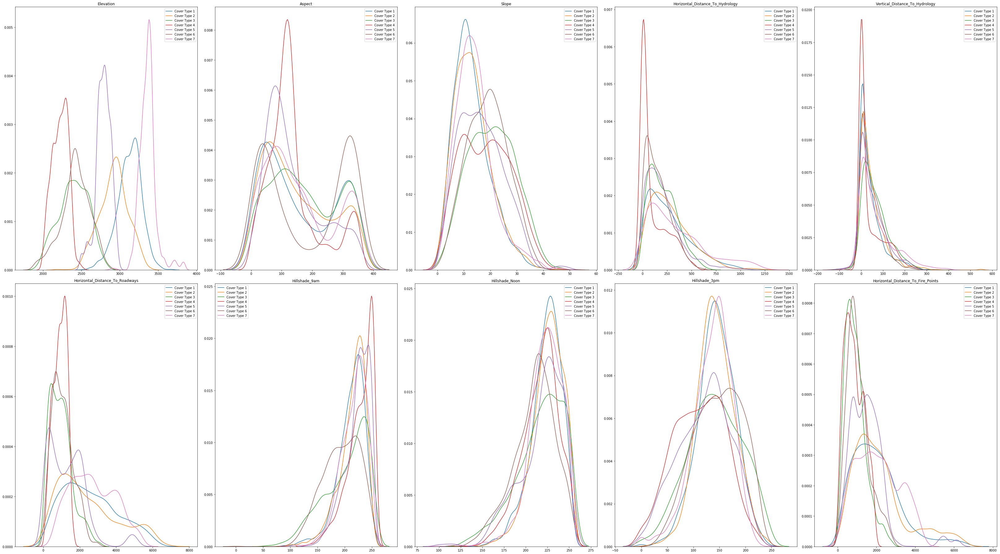

In [23]:
numeric_tile(compare_dist)

### Compare train and test features

In [24]:
#histograms of train vs test

def compare_dist(ax, feature, i=0):
    sns.kdeplot(df_train[feature], label="train", ax=ax)
    sns.kdeplot(df_test[feature], label="test", ax=ax)


def numeric_tile(plot_func):
    fig, axs = plt.subplots(2, 5, figsize=(24, 10))
    axs = axs.flatten()
    
    for i, (ax, col) in enumerate(zip(axs, features)):
        plot_func(ax, col, i)
        ax.set_title(col)
    plt.tight_layout()

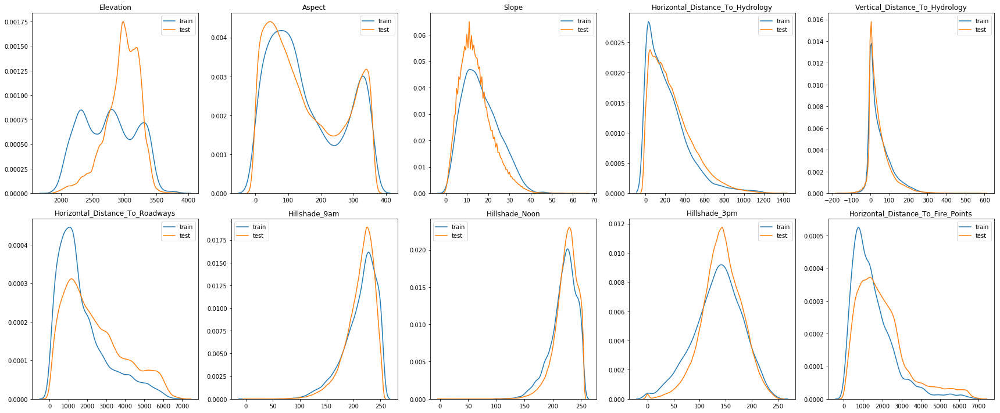

In [25]:
numeric_tile(compare_dist)

Elevation is quite different between train and test set

## Analysis of outliers

In [26]:
feature = 'Horizontal_Distance_To_Roadways'
trace = []
group_labels = []

for i in covertypes:
    trace.append(go.Box(y = df_train[df_train['Cover_Type']==i][feature], name = f'Cover type {int(i)}'))

layout = go.Layout(showlegend=False, xaxis = dict(tickfont=dict(size=12)), title = f"Box plot of {feature}")

fig = go.Figure(data=trace, layout=layout)

plotly.offline.iplot(fig, filename="Box Plot Styling Outliers")

### Number of outliers based on IQR

#### Outliers for all cover types

In [27]:
Q1 = df_train[features].quantile(0.25)
Q3 = df_train[features].quantile(0.75)
IQR = Q3 - Q1

out_tm = ((df_train[features] < (Q1 - 1.5 * IQR)) | (df_train[features] > (Q3 + 1.5 * IQR)))
outliers_iqr = pd.DataFrame(data={'outliers_IQR_count':out_tm.sum(),\
                              'outliers_IQR_%':100*out_tm.sum()/df_train.shape[0]})

outliers_iqr.sort_values(by='outliers_IQR_count',ascending=False)

,outliers_IQR_count,outliers_IQR_%
Horizontal_Distance_To_Roadways,830,5.489418
Horizontal_Distance_To_Fire_Points,645,4.265873
Vertical_Distance_To_Hydrology,586,3.875661
Horizontal_Distance_To_Hydrology,512,3.386243
Hillshade_9am,408,2.698413
Hillshade_Noon,393,2.599206
Hillshade_3pm,124,0.820106
Slope,57,0.376984
Elevation,0,0.000000
Aspect,0,0.000000


Horizontal and Vertical distances features are the ones with more outliers based on IQR

#### Outliers broken down by cover type

In [28]:
indexes = [f'Cover_Type{x}' for x in covertypes]

dic_ = {}

#definir en numero de features a mostrar
feature=['Elevation']

for feat in feature:
       
    out = []
    out_pct = []
    for ct in covertypes:
    
        df_ct = df_train.loc[df_train['Cover_Type']==ct]
        
    
        Q1 = df_ct[feat].quantile(0.25)
        Q3 = df_ct[feat].quantile(0.75)
        IQR = Q3 - Q1
    
        out_tm = ((df_ct[feat] < (Q1 - 1.5 * IQR)) | (df_ct[feat] > (Q3 + 1.5 * IQR)))
        out.append(out_tm.sum())
        out_pct.append(100*out_tm.sum()/df_ct.shape[0])
    dic_[f'{feat}_IQR_outliers'] = out
    dic_[f'{feat}_%_IQR_outliers'] = out_pct  


df_outliers_iqr = pd.DataFrame(dic_,index=indexes)
df_outliers_iqr

,Elevation_IQR_outliers,Elevation_%_IQR_outliers
Cover_Type1,43,1.990741
Cover_Type2,9,0.416667
Cover_Type3,0,0.000000
Cover_Type4,0,0.000000
Cover_Type5,45,2.083333
Cover_Type6,41,1.898148
Cover_Type7,88,4.074074


##### IQR outliers all features grouped by Cover_Type 

In [29]:
indexes = [f'Cover_Type{x}' for x in covertypes]


dic_ = {}

#definir en numero de features a mostrar
feat_num = [feat for feat in features_all if ('Wilderness' not in feat) & ('Soil' not in feat) & ('Cover' not in feat)]

for feat in feat_num:
       
    out = []
    out_pct = []
    for ct in covertypes:
    
        df_ct = df_train.loc[df_train['Cover_Type']==ct]
        
    
        Q1 = df_ct[feat].quantile(0.25)
        Q3 = df_ct[feat].quantile(0.75)
        IQR = Q3 - Q1
    
        out_tm = ((df_ct[feat] < (Q1 - 1.5 * IQR)) | (df_ct[feat] > (Q3 + 1.5 * IQR)))
        out.append(out_tm.sum())
        #out_pct.append(100*out_tm.sum()/df_ct.shape[0])
    dic_[f'{feat}_IQR_outliers'] = out
    #dic_[f'{feat}_%_outliers'] = out_pct  


df_outliers_iqr_total = pd.DataFrame(dic_,index=indexes)
df_outliers_iqr_total

,Elevation_IQR_outliers,Aspect_IQR_outliers,Slope_IQR_outliers,Horizontal_Distance_To_Hydrology_IQR_outliers,Vertical_Distance_To_Hydrology_IQR_outliers,Horizontal_Distance_To_Roadways_IQR_outliers,Hillshade_9am_IQR_outliers,Hillshade_Noon_IQR_outliers,Hillshade_3pm_IQR_outliers,Horizontal_Distance_To_Fire_Points_IQR_outliers
Cover_Type1,43,0,44,45,137,0,66,51,25,77
Cover_Type2,9,0,49,40,120,1,67,42,25,164
Cover_Type3,0,0,1,9,44,40,6,31,0,66
Cover_Type4,0,263,0,32,84,0,41,32,0,0
Cover_Type5,45,0,16,83,72,76,42,24,0,69
Cover_Type6,41,0,2,19,35,18,2,18,0,63
Cover_Type7,88,0,71,41,82,0,29,49,48,0


In [30]:
#trace = []
#group_labels = []

#feat_num = [feat for feat in df_outliers_total.columns]

#for i in np.sort(df_outliers_total.index.to_list()):
    #trace.append(go.Bar(x=feat_num, y = df_outliers_total.loc[df_outliers_total.index==i,feat_num].get_values()[0], name = str(i)))
    
#data = trace
#layout = go.Layout(xaxis = dict(tickfont=dict(size=7)))
#fig = go.Figure(data=data, layout=layout)

#plotly.offline.iplot(fig)

###### Total outliers by Cover_Type

In [31]:
nums = [(lambda cover : df_outliers_iqr_total.loc[cover].sum()) (cover) for cover in df_outliers_iqr_total.index.tolist()]
df_outliers_ct_iqr = pd.DataFrame(data = {'Outliers_IQR_Total':nums,'%_IQR': ([(lambda i: 100*i/np.sum(nums))(i) for i in nums])},\
                              index = df_outliers_iqr_total.index.to_list())
df_outliers_ct_iqr.sort_values(by='Outliers_IQR_Total', ascending=False)

AttributeError: 'Index' object has no attribute 'to_list'

In [ ]:
trace = []
group_labels = []

trace = [go.Bar(x = df_outliers_ct_iqr.index.to_list(), y = df_outliers_ct_iqr.iloc[:,0].to_list(),
               marker=dict(color='rgba(50, 171, 96, 0.6)',line=dict(color='rgba(50, 171, 96, 1.0)',width=1)))]
    

layout = go.Layout(barmode='group',xaxis = dict(tickfont=dict(size=10)), title = 'Total Outliers IQR per Cover_Type')
fig = go.Figure(data=trace, layout=layout)

plotly.offline.iplot(fig)

### Number of outliers based on SD

In [ ]:
cutoff = 4

ct_mean, ct_std = np.mean(df_train[features]), np.std(df_train[features])
cut_off = ct_std * cutoff
lower, upper = ct_mean - cut_off, ct_mean + cut_off
out_tm = ((df_train[features] < lower) | (df_train[features] > upper))
outliers_sd = pd.DataFrame(data = {'outliers_SD_count':out_tm.sum(),\
                                  'outliers_SD_%':100*out_tm.sum()/df_train.shape[0]})
outliers_sd.sort_values(by='outliers_SD_count',ascending=False)

In [ ]:
dic_ = {}

#definir en numero de features a mostrar
feature=['Elevation']
#definir cutoff:
cutoff = 4

for feat in feature:
    
    out = []
    out_pct = []
    
    for ct in covertypes:
    
        df_ct = df_train.loc[df_train['Cover_Type']==ct]
        
        ct_mean, ct_std = np.mean(df_ct[feat]), np.std(df_ct[feat])
        cut_off = ct_std * cutoff
        lower, upper = ct_mean - cut_off, ct_mean + cut_off
    
        out_tm = ((df_ct[feat] < lower) | (df_ct[feat] > upper))
        out.append(out_tm.sum())
        out_pct.append(100*out_tm.sum()/df_ct.shape[0])
    dic_[f'{feat}_SD_outliers'] = out
    dic_[f'{feat}_%_SD_outliers'] = out_pct  

df_outliers_sd = pd.DataFrame(dic_,index=indexes)
df_outliers_sd

In [ ]:
indexes = [f'Cover_Type{x}' for x in covertypes]


dic_ = {}

#definir en numero de features a mostrar
feat_num = [feat for feat in features_all if ('Wilderness' not in feat) & ('Soil' not in feat) & ('Cover' not in feat)]

for feat in feat_num:
       
    out = []
    out_pct = []
    for ct in covertypes:
    
        df_ct = df_train.loc[df_train['Cover_Type']==ct]
        
    
        ct_mean, ct_std = np.mean(df_ct[feat]), np.std(df_ct[feat])
        cut_off = ct_std * cutoff
        lower, upper = ct_mean - cut_off, ct_mean + cut_off
    
        out_tm = ((df_ct[feat] < lower) | (df_ct[feat] > upper))
        out.append(out_tm.sum())
        #out_pct.append(100*out_tm.sum()/df_ct.shape[0])
    dic_[f'{feat}_SD_outliers'] = out
    #dic_[f'{feat}_%_outliers'] = out_pct  


df_outliers_total_sd = pd.DataFrame(dic_,index=indexes)
df_outliers_total_sd

In [ ]:
nums = [(lambda cover : df_outliers_total_sd.loc[cover].sum()) (cover) for cover in df_outliers_total_sd.index.to_list()]
df_outliers_ct_sd = pd.DataFrame(data = {'Outliers_Total_SD':nums,'%_SD': ([(lambda i: 100*i/np.sum(nums))(i) for i in nums])},\
                              index = df_outliers_total_sd.index.to_list())
df_outliers_ct_sd 

In [ ]:
trace = []
group_labels = []

trace = [go.Bar(x = df_outliers_ct_sd.index.to_list(), y = df_outliers_ct_sd.iloc[:,0].to_list(),
               marker=dict(color='rgba(50, 171, 96, 0.6)',line=dict(color='rgba(100, 171, 86, 5.0)',width=1)))]
    

layout = go.Layout(barmode='group',xaxis = dict(tickfont=dict(size=10)), title = 'Total Outliers SD per Cover_Type')
fig = go.Figure(data=trace, layout=layout)

plotly.offline.iplot(fig)

### Compare between IQR and SD outliers

In [ ]:
diff_otl = df_outliers_ct_sd.merge(df_outliers_ct_iqr, left_index = True, right_index=True)
diff_otl['diff_%'] = diff_otl['%_IQR'] - diff_otl['%_SD']
diff_otl.sort_values('diff_%',ascending=False)

## Cleaning of soils type

In [ ]:
#dataframe subset to select the Soils without targets
df_soils = df_train.groupby(['Cover_Type'])[feat_soils].sum()
df_soils.head()

In [ ]:
trace = []
name = []

for i in range(len(df_soils.index.values)):
    trace.append(go.Bar(x = feat_soils,y=df_soils.iloc[i]))
    name.append(f'Cover Type {i+1}')

   
fig = tools.make_subplots(rows=7, cols=1,subplot_titles = name, vertical_spacing = 0.1 )


for k in fig['layout'].annotations:
    k['font'].update(size=10)
    

fig['layout'].update(showlegend=False, height=1500, width=1000, title='Target Counts per Soil_Type')



m = 0
#row
for x in range(1,8):
    #column
    for n in range(1,2):
        fig.append_trace(trace[m], x, n)
        m = m + 1


plotly.offline.iplot(fig) 

In [ ]:
print(f"Is every training datapoint assigned only one soil type? {(df_train[feat_soils].sum(axis = 1) == 1).all()}")
print(f"Is every test datapoint assigned only one soil type? {(df_test[feat_soils].sum(axis = 1) == 1).all()}")

In [ ]:
soils_not_used_train = []
for feat, i in (df_train[feat_soils].sum() ==0).iteritems():
    if i:
        soils_not_used_train.append(feat)
        print(f"{feat} is not used in train but has {df_test[feat].sum()} instances on test")

#### Compare occurences of soil between train and test

In [ ]:
soils_types = pd.DataFrame(data={'soils_count_train':df_train[feat_soils].sum(),\
                                 'soils_count_test':df_test[feat_soils].sum(),\
                                 'soils_percentage_train':100*df_train[feat_soils].sum()/num_train,\
                                 'soils_percentage_test':100*df_test[feat_soils].sum()/num_test})
soils_types

In [ ]:
trace0 = go.Scatter(x=soils_types.index,y=soils_types['soils_percentage_train'], name = 'train')
trace1 = go.Scatter(x=soils_types.index,y=soils_types['soils_percentage_test'], name = 'test')
fig = go.Figure(data=[trace0,trace1])
fig['layout'].update(title='Percentage of soil type')
plotly.offline.iplot(fig, filename='basic-line')


## Cleaning data for wilderness areas

In [ ]:
#dataframe subset to select the wilderness areas without targets
feat_wild = [feat for feat in features_all if 'Wilderness' in feat]
df_wilderness = df_train.groupby(['Cover_Type'])[feat_wild].sum()
df_wilderness.head()

In [ ]:
trace = []
name = []

for i in range(len(df_wilderness.index.values)):
    trace.append(go.Bar(x = df_wilderness.columns,y=df_wilderness.iloc[i]))
    name.append(f"Cover Type {i+1}")

   
fig = tools.make_subplots(rows=7, cols=1,subplot_titles = name, vertical_spacing = .1)


for k in fig['layout'].annotations:
    k['font'].update(size=10)
    

fig['layout'].update(showlegend=False, height=1200, width=600, title='Target Counts per Wilderness')


m = 0
#row
for x in range(1,8):
    #column
    for n in range(1,2):
        fig.append_trace(trace[m], x, n)
        m = m + 1


plotly.offline.iplot(fig) 

In [ ]:
print(f"Is every training datapoint assigned only one wilderness type? {(df_train[feat_wild].sum(axis = 1) == 1).all()}")
print(f"Is every test datapoint assigned only one wilderness type? {(df_test[feat_wild].sum(axis = 1) == 1).all()}")

In [ ]:
wild_not_used_train = []
for feat, i in (df_train[feat_wild].sum() ==0).iteritems():
    if i:
        wild_not_used_train.append(feat)
        print(f"{feat} is not used in train but has {df_test[feat].sum()} instances on test")



#### Compare occurences of soil between train and test

In [ ]:
wild_types = pd.DataFrame(data={'wilderness_count_train':df_train[feat_wild].sum(),\
                                 'wilderness_count_test':df_test[feat_wild].sum(),\
                                 'wilderness_percentage_train':100*df_train[feat_wild].sum()/num_train,\
                                 'wilderness_percentage_test':100*df_test[feat_wild].sum()/num_test})
wild_types

In [ ]:
trace0 = go.Scatter(x=wild_types.index,y=wild_types['wilderness_percentage_train'], name = 'train')
trace1 = go.Scatter(x=wild_types.index,y=wild_types['wilderness_percentage_test'], name = 'test')
fig = go.Figure(data=[trace0,trace1])
fig['layout'].update(title='Percentage of wilderness type')
plotly.offline.iplot(fig, filename='basic-line')


### Feature Correlation

In [ ]:
feat_num = [feat for feat in features_all if ('Wilderness' not in feat) & ('Soil' not in feat)]
print(feat_num)

In [ ]:
# Compute Pearson correlation for every pair of features
# Use only training data
pcorrs = pd.DataFrame(df_train[feat_num].corr()['Cover_Type'].sort_values()).reset_index()
pcorrs = pcorrs.rename(columns = {'index': 'feature','Cover_Type': 'pcorr'})

print('Most negatively correlated variables:')
print(pcorrs.head())

print('\nMost positively correlated variables:')
print(pcorrs.dropna().tail())

In [ ]:
# Compute Spearman correlation for every features
# Use only training data
from scipy.stats import spearmanr
feats = []
scorr = []
pvalues = []

# Iterate through each column
for feat in feat_num:
 
    # Calculate spearman correlation
    scorr.append(spearmanr(df_train[feat], df_train['Cover_Type']).correlation)
    pvalues.append(spearmanr(df_train[feat], df_train['Cover_Type']).pvalue)

scorrs = pd.DataFrame({'feature': feat_num, 'scorr': scorr, 'pvalue': pvalues}).sort_values('scorr')

print('Most negative Spearman correlations:')
print(scorrs.head())
print('\nMost positive Spearman correlations:')
print(scorrs.dropna().tail())

In [ ]:
# Compute features for which PEarson and Spearman correlation differs the most
corrs = pcorrs.merge(scorrs, on = 'feature')
corrs['diff'] = corrs['pcorr'] - corrs['scorr']

corrs.sort_values('diff').head()

Correlations using both methods are very similar

In [ ]:
plt.figure(figsize=(15, 10))
sns.set(font_scale=1.25)
sns.heatmap(df_train[feat_num].corr(), square=True, cmap='RdYlGn',annot=True,annot_kws={'size': 9},fmt='.2f')

As one would expect, hillshades at three different times are moderately correlated with each other. 
Elevation is positively correlated with the three horizontal distances (hydrology, roadways, fire points), which makes intuitive sense.
Slope is negatively correlated with hillshade, specially at noon, thus implying more slope equals less sunlight.

# Model and prediction
We first establish a baseline using Random Forest, and then we will move on to more sophisticated ML models and feature selection strategies

In [121]:
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestClassifier
# from sklearn.model_selection import GridSearchCV
# from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report, roc_auc_score, roc_curve, make_scorer, f1_score

from sklearn.preprocessing import MinMaxScaler
from sklearn.pipeline import Pipeline

# Since the dataset is class-balanced, we can use macro averaging for the F1 scorer
scorer = make_scorer(f1_score, greater_is_better=True, average = 'macro')


In [122]:
# Extract training data and labels
train_set = df_train.drop(columns = ['Cover_Type','Id'])
test_set = df_test.drop(columns = ['Id'])
test_ids = df_test['Id'].values
train_labels = np.asarray(df_train['Cover_Type'])
[num_examples,num_feat] = train_set.shape

# Submission base which is used for making submissions to the competition
submission_base = df_test[['Id']].copy()

In [123]:
# Create pipeline for scaling
features = train_set.columns.tolist()
pipeline = Pipeline([('scaler', MinMaxScaler())])
# pipeline = Pipeline([('scaler', StandardScaler())])

# Fit and transform training data
train_set = pipeline.fit_transform(train_set)
test_set = pipeline.transform(test_set)

In [124]:
# Routine to plot feature importances
def plot_feature_importances(df, n = 10, threshold = None):
    """Plots n most important features. Also plots the cumulative importance if
    threshold is specified and prints the number of features needed to reach threshold cumulative importance.
    Intended for use with any tree-based feature importances. 
    
    Args:
        df (dataframe): Dataframe of feature importances. Columns must be "feature" and "importance".
    
        n (int): Number of most important features to plot. Default is 10.
    
        threshold (float): Threshold for cumulative importance plot. If not provided, no plot is made. Default is None.
        
    Returns:
        df (dataframe): Dataframe ordered by feature importances with a normalized column (sums to 1) 
                        and a cumulative importance column
    
    Note:
    
        * Normalization in this case means sums to 1. 
        * Cumulative importance is calculated by summing features from most to least important
        * A threshold of x will show the most important features needed to reach 100*x% of cumulative importance
    
    """    
    # Sort features with most important at the head
    df = df.sort_values('importance', ascending = False).reset_index(drop = True)
    
    # Normalize the feature importances to add up to one and calculate cumulative importance
    df['importance_normalized'] = df['importance'] / df['importance'].sum()
    df['cumulative_importance'] = np.cumsum(df['importance_normalized'])
        
    # Bar plot of n most important features
    trace0 = go.Bar(
                    y=df.loc[:n,'feature'],
                    x=df.loc[:n,'importance_normalized'],
                    marker=dict(
                        color='rgba(50, 171, 96, 0.6)',
                        line=dict(
                            color='rgba(50, 171, 96, 1.0)',
                            width=1),
                    ), orientation = 'h')
    layout = go.Layout(title='Normalized importance of features',
                      yaxis = dict(autorange = "reversed",
                                  tickangle = 0,
                                  automargin=True),
                      width=800)

    fig = go.Figure(data=[trace0], layout=layout)
    plotly.offline.iplot(fig, filename='norm-importance')
    
    
    if threshold:
        # Number of features needed for threshold cumulative importance
        # This is the index (will need to add 1 for the actual number)
        importance_index = np.min(np.where(df['cumulative_importance'] > threshold))
        
        # Cumulative importance plot        
        trace0 = go.Scatter(x=df.index,y=df['cumulative_importance'],line = dict(color = 'blue'))
        trace1 = go.Scatter(x=[importance_index + 1,importance_index + 1],y=[0,1.02],
                            line = dict(color = 'red',
                                       dash ='dash'))
        
        fig1 = go.Figure(data=[trace0,trace1])
        fig1['layout'].update(title='Cumulative Feature Importance',
                            xaxis = dict(title='Number of Features'),
                            yaxis = dict(title='Cumulative Importance'),
                             showlegend=False)
        plotly.offline.iplot(fig1, filename='basic-line')

        print(f'{importance_index + 1} features required for {100*threshold}% of cumulative importance.')
    
    return df

In [125]:
# Routine to train a model with cross-validation and append the results to a dataframe

model_results = pd.DataFrame(columns = ['model','cv_mean','cv_std'])

def run_cv_model(model, train_set, train_labels, name, model_results = None, nfolds = 10):
    
    """ Perform K-fold CV of the given model"""
    
    cv_scores = cross_val_score(model, train_set, train_labels, cv=nfolds, scoring=scorer)
    
    print(f'{nfolds}-Fold Cross Validation F1 Score = {round(cv_scores.mean(), 4)} with std = {round(cv_scores.std(), 4)}')
    
    if model_results is not None:
        model_results = model_results.append(pd.DataFrame({'model':name,
                                                           'cv_mean':cv_scores.mean(),
                                                           'cv_std': cv_scores.std()}, index=[0]),
                                            ignore_index=True)
        return model_results
    
    

In [126]:
# Routine to plot scores of model_results

def plot_scores(model):
#     model.set_index('model', inplace=True)
    
    trace0 = go.Bar(
                    y=model['cv_mean'],
                    x=model['model'],
                    marker=dict(
                        color='orange',
                        line=dict(
                            color='black',
                            width=1),
                    ),
                    error_y=dict(
                            type='data',
                            array=model['cv_std'],
                            visible=True,
                            color ='black')
                    )
    
    layout = go.Layout(title='F1 scores of models',
                      width=800, xaxis = dict(tickfont=dict(size=14), automargin=True))

    fig = go.Figure(data=[trace0], layout=layout)
    plotly.offline.iplot(fig, filename='F1-scores')
    

In [127]:
model_results

,model,cv_mean,cv_std


### Random Forest initial classifier
Use 10-fold cross validation to get prediction results

In [128]:
model_rf = RandomForestClassifier(n_estimators=100, random_state=10, n_jobs = -1)
# 10 fold cross validation
model_results = run_cv_model(model_rf, train_set, train_labels, 'RF', model_results)


10-Fold Cross Validation F1 Score = 0.7779 with std = 0.0427


Examine feature importances using the whole training set to fit

In [129]:
model_rf.fit(train_set, train_labels)

# Feature importances into a dataframe
feature_importances = pd.DataFrame({'feature': features, 'importance': model_rf.feature_importances_})
feature_importances.head()


,feature,importance
0,Elevation,0.236056
1,Aspect,0.050657
2,Slope,0.036100
3,Horizontal_Distance_To_Hydrology,0.061912
4,Vertical_Distance_To_Hydrology,0.054358


In [130]:
norm_fi = plot_feature_importances(feature_importances, threshold=0.95)

24 features required for 95.0% of cumulative importance.


#### Use recursive feature elimination to improve RF

In [131]:
from sklearn.feature_selection import RFECV

# Create a model for feature selection
estimator = RandomForestClassifier(random_state = 10, n_estimators = 100,  n_jobs = -1)

# Create the object
selector = RFECV(estimator, step = 1, cv = 3, scoring= scorer, n_jobs = -1)

In [132]:
# Fit to training data
selector.fit(train_set, train_labels)

RFECV(cv=3,
   estimator=RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=100, n_jobs=-1,
            oob_score=False, random_state=10, verbose=0, warm_start=False),
   n_jobs=-1, scoring=make_scorer(f1_score, average=macro), step=1,
   verbose=0)

In [133]:
features_selected = [feat for (i,feat) in enumerate(features) if selector.ranking_[i]==1]

In [134]:
# Plot results
trace0 = go.Scatter(x=np.asarray(range(1,1+num_feat)),y=selector.grid_scores_,line = dict(color = 'blue'))
trace1 = go.Scatter(x=[selector.n_features_,selector.n_features_],
                    y=[np.min(selector.grid_scores_),np.max(selector.grid_scores_)],
                            line = dict(color = 'red',
                                       dash ='dash'))
fig1 = go.Figure(data=[trace0,trace1])
fig1['layout'].update(title=f'Recursive feature elimination -- score improves up to {selector.n_features_} features',
                              xaxis = dict(title='Number of Features'),
                              yaxis = dict(title='Macro F1 score'),
                              showlegend=False)
plotly.offline.iplot(fig1, filename='basic-line')

In [135]:
# Retrain the model 
model_results = run_cv_model(model_rf,selector.transform(train_set),train_labels,'RF-RFE', model_results)

10-Fold Cross Validation F1 Score = 0.7802 with std = 0.0424


### Compare multiple models
Run several models for classification (without fine tuning) to determine a good baseline model that works for this dataset

In [136]:
from sklearn.svm import LinearSVC
from sklearn.naive_bayes import GaussianNB
from sklearn.neural_network import MLPClassifier
from sklearn.linear_model import LogisticRegressionCV, RidgeClassifierCV
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.neighbors import KNeighborsClassifier


In [137]:
# Run linear SVM
model_results = run_cv_model(LinearSVC(), train_set, train_labels, 'LSVC', model_results)

10-Fold Cross Validation F1 Score = 0.6212 with std = 0.0669


In [138]:
# Run  Gaussian Naive Bayes
model_results = run_cv_model(GaussianNB(), train_set, train_labels, 'GNB', model_results)

10-Fold Cross Validation F1 Score = 0.3486 with std = 0.0632


/anaconda3/lib/python3.6/site-packages/sklearn/metrics/classification.py:1135: UndefinedMetricWarning:

F-score is ill-defined and being set to 0.0 in labels with no predicted samples.



In [139]:
# Run  Multi-layer perceptron
model_results = run_cv_model(MLPClassifier(hidden_layer_sizes = (32, 64, 128, 64, 32), max_iter = 500),
                             train_set, train_labels, 'MLP-0', model_results)

model_results = run_cv_model(MLPClassifier(hidden_layer_sizes = (128, 256, 256, 128, 32), max_iter = 500),
                             train_set, train_labels, 'MLP-1', model_results)

10-Fold Cross Validation F1 Score = 0.6803 with std = 0.0227
10-Fold Cross Validation F1 Score = 0.7122 with std = 0.0505


In [140]:
# Run  LDA
model_results = run_cv_model(LinearDiscriminantAnalysis(), train_set, train_labels, 'LDA', model_results)
model_results = run_cv_model(LinearDiscriminantAnalysis(), selector.transform(train_set),
                             train_labels, 'LDA-RFE', model_results)

/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:442: UserWarning:

The priors do not sum to 1. Renormalizing

/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning:

Variables are collinear.

/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:442: UserWarning:

The priors do not sum to 1. Renormalizing

/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning:

Variables are collinear.

/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:442: UserWarning:

The priors do not sum to 1. Renormalizing

/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning:

Variables are collinear.

/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:442: UserWarning:

The priors do not sum to 1. Renormalizing

/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning:

Variables are collinea

10-Fold Cross Validation F1 Score = 0.6045 with std = 0.0684
10-Fold Cross Validation F1 Score = 0.6027 with std = 0.0672


/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:442: UserWarning:

The priors do not sum to 1. Renormalizing

/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning:

Variables are collinear.

/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:442: UserWarning:

The priors do not sum to 1. Renormalizing

/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning:

Variables are collinear.

/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:442: UserWarning:

The priors do not sum to 1. Renormalizing

/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning:

Variables are collinear.

/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:442: UserWarning:

The priors do not sum to 1. Renormalizing

/anaconda3/lib/python3.6/site-packages/sklearn/discriminant_analysis.py:388: UserWarning:

Variables are collinea

In [141]:
# Run  Logistic Regression
model_results = run_cv_model(LogisticRegressionCV(), train_set, train_labels, 'LR', model_results)

10-Fold Cross Validation F1 Score = 0.6243 with std = 0.0661


In [142]:
# Run  Ridge Regression
model_results = run_cv_model(RidgeClassifierCV(), train_set, train_labels, 'RR', model_results)

10-Fold Cross Validation F1 Score = 0.5772 with std = 0.0689


In [143]:
# Run  KNN
kn = [3, 5, 10, 20]
for n in kn:
    model_results = run_cv_model(KNeighborsClassifier(n_neighbors=n),
                                 train_set, train_labels, f'KNN-{n}', model_results)

10-Fold Cross Validation F1 Score = 0.7035 with std = 0.047
10-Fold Cross Validation F1 Score = 0.6941 with std = 0.0459
10-Fold Cross Validation F1 Score = 0.6716 with std = 0.0433
10-Fold Cross Validation F1 Score = 0.6468 with std = 0.0485


In [144]:
plot_scores(model_results)

### Use gradient boosting

In [145]:
def macro_f1_score(labels, predictions):
    # Reshape the predictions as needed
    predictions = predictions.reshape(len(np.unique(labels)), -1 ).argmax(axis = 0)
    
    metric_value = f1_score(labels, predictions, average = 'macro')
    
    # Return is name, value, is_higher_better
    return 'macro_f1', metric_value, True

In [146]:
from sklearn.model_selection import StratifiedKFold
import lightgbm as lgb


def model_gbm(train_set, train_labels, feature_names, test_set, test_ids, 
              nfolds = 3, return_preds = False, hyp = None):
    """Model using the GBM and cross validation.
       Trains with early stopping on each fold.
       Hyperparameters probably need to be tuned."""
    
    # Option for user specified hyperparameters
    if hyp is not None:
        # Using early stopping so do not need number of estimators
        if 'n_estimators' in hyp:
            del hyp['n_estimators']
        params = hyp
    
    else:
        # Model hyperparameters
        params = {'boosting_type': 'dart', 
                  'colsample_bytree': 0.88, 
                  'learning_rate': 0.028, 
                   'min_child_samples': 10, 
                   'num_leaves': 36, 'reg_alpha': 0.76, 
                   'reg_lambda': 0.43, 
                   'subsample_for_bin': 40000, 
                   'subsample': 0.54, 
                   'class_weight': 'balanced'}
    
    # Build the model
    model = lgb.LGBMClassifier(**params, objective = 'multiclass', 
                               n_jobs = -1, n_estimators = 10000,
                               random_state = 10)
    
    # Using stratified kfold cross validation
    strkfold = StratifiedKFold(n_splits = nfolds, shuffle = True)
    
    # Hold all the predictions from each fold
    predictions = pd.DataFrame()
    importances = np.zeros(len(feature_names))
    
    
    valid_scores = []
    
    # Iterate through the folds
    for i, (train_indices, valid_indices) in enumerate(strkfold.split(train_set, train_labels)):
        
        # Dataframe for fold predictions
        fold_predictions = pd.DataFrame()
        
        # Training and validation data
        X_train = train_set[train_indices.tolist(), :]
        X_valid = train_set[valid_indices.tolist(), :]
        y_train = train_labels[train_indices.tolist()]
        y_valid = train_labels[valid_indices.tolist()]
        
        # Train with early stopping
        model.fit(X_train, y_train, early_stopping_rounds = 100, 
                  eval_metric = macro_f1_score,
                  eval_set = [(X_train, y_train), (X_valid, y_valid)],
                  eval_names = ['train', 'valid'],
                  verbose = 300)
        
        # Record the validation fold score
        valid_scores.append(model.best_score_['valid']['macro_f1'])
        
        # Make predictions from the fold as probabilities
        fold_probabilitites = model.predict_proba(test_set)
        
        # Record each prediction for each class as a separate column
        for j in range(len(covertypes)):
            fold_predictions[(j + 1)] = fold_probabilitites[:, j]
            
        # Add needed information for predictions 
        fold_predictions['Id'] = test_ids
        fold_predictions['fold'] = (i+1)
        
        # Add the predictions as new rows to the existing predictions
        predictions = predictions.append(fold_predictions)
        
        # Feature importances
        importances += model.feature_importances_ / nfolds   
        
        # Display fold information
        print(f'Fold {i + 1}, Validation Score: {round(valid_scores[i], 5)}, Estimators Trained: {model.best_iteration_}')
        print('---------------------------------------------------------------------------------------------------------')

    # Feature importances dataframe
    feature_importances = pd.DataFrame({'feature': feature_names,
                                        'importance': importances})
    
    valid_scores = np.array(valid_scores)
    print(f'{nfolds}-fold cross validation score: {round(valid_scores.mean(), 5)} with std: {round(valid_scores.std(), 5)}.')
    
    # If we want to examine predictionson test set don't average over folds
    if return_preds:
        predictions['Cover_Type'] = predictions[covertypes].idxmax(axis = 1)
        predictions['confidence'] = predictions[covertypes].max(axis = 1)
        return predictions, feature_importances, valid_scores
    
    # Average the predictions on test set over folds
    predictions = predictions.groupby('Id', as_index = False).mean()
    
    # Find the class and associated probability
    predictions['Cover_Type'] = predictions[covertypes].idxmax(axis = 1)
    predictions['confidence'] = predictions[covertypes].max(axis = 1)
    predictions = predictions.drop(columns = ['fold'])
    
    # Merge with the base to have one prediction for each individual
    submission = submission_base.merge(predictions[['Id', 'Cover_Type', 'confidence']], on = 'Id', how = 'left')
            
    # return the submission and feature importances along with validation scores
    return submission, feature_importances, valid_scores

In [147]:
predictions, gbm_fi, valid_scores = model_gbm(train_set, train_labels, features, test_set, test_ids, return_preds=True)

Training until validation scores don't improve for 100 rounds.
[300]	train's multi_logloss: 0.720788	train's macro_f1: 0.865714	valid's multi_logloss: 0.796115	valid's macro_f1: 0.811223
[600]	train's multi_logloss: 0.436543	train's macro_f1: 0.896418	valid's multi_logloss: 0.553703	valid's macro_f1: 0.827387
[900]	train's multi_logloss: 0.297332	train's macro_f1: 0.937494	valid's multi_logloss: 0.453522	valid's macro_f1: 0.839708
[1200]	train's multi_logloss: 0.240198	train's macro_f1: 0.958638	valid's multi_logloss: 0.421767	valid's macro_f1: 0.846067
[1500]	train's multi_logloss: 0.190824	train's macro_f1: 0.97606	valid's multi_logloss: 0.399005	valid's macro_f1: 0.847984
Early stopping, best iteration is:
[1434]	train's multi_logloss: 0.19892	train's macro_f1: 0.972945	valid's multi_logloss: 0.40241	valid's macro_f1: 0.849649
Fold 1, Validation Score: 0.84965, Estimators Trained: 1434
--------------------------------------------------------------------------------------------------

In [148]:
_ = plot_feature_importances(gbm_fi, threshold=0.95)

22 features required for 95.0% of cumulative importance.


We now plot the confidence level for each cover type on each fold

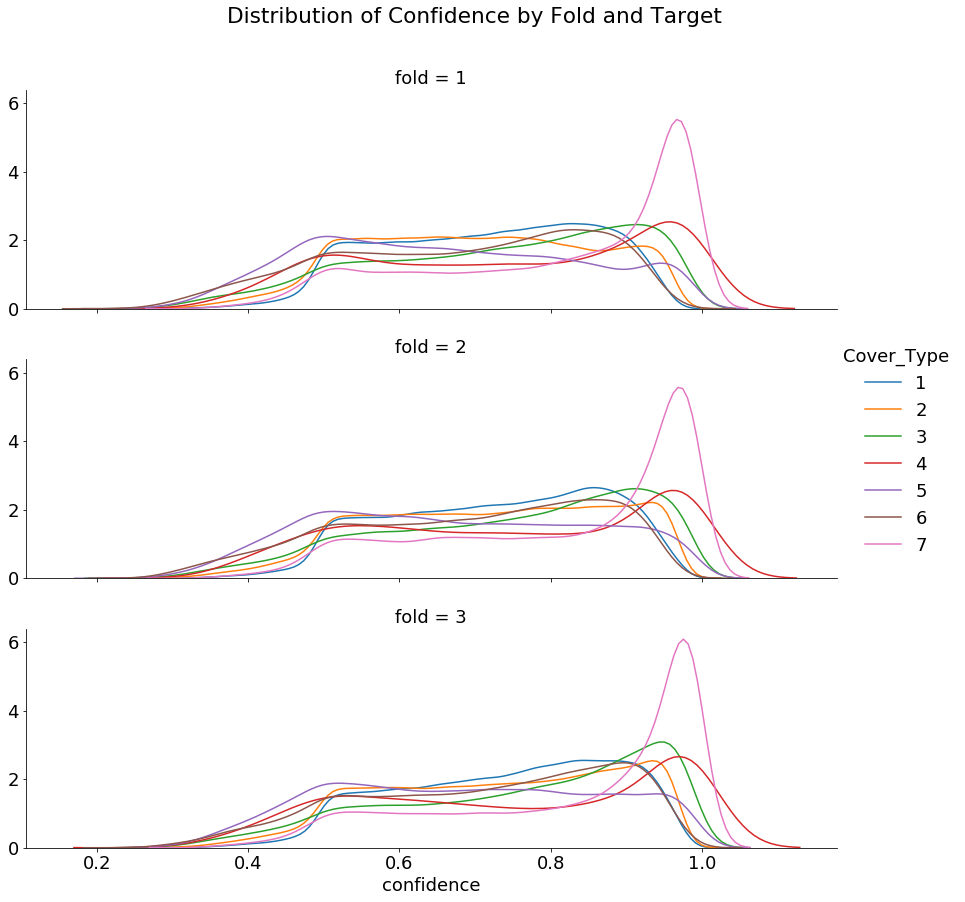

In [149]:
plt.rcParams['font.size'] = 18

# Kdeplot
g = sns.FacetGrid(predictions, row = 'fold', hue = 'Cover_Type', height = 4, aspect = 3)
g.map(sns.kdeplot, 'confidence');
g.add_legend();

plt.suptitle('Distribution of Confidence by Fold and Target', y = 1.05);

In [150]:
# Average the predictions on test set over folds
predictions_avg = predictions.groupby('Id', as_index = False).mean()
    
# Find the class and associated probability
predictions_avg['Cover_Type'] = predictions_avg[covertypes].idxmax(axis = 1)
predictions_avg['confidence'] = predictions_avg[covertypes].max(axis = 1)
predictions_avg = predictions_avg.drop(columns = ['fold'])

In [151]:
trace = []
group_labels = []

for i in covertypes:
    trace.append(go.Box(y = predictions_avg[predictions_avg['Cover_Type']==i]['confidence'], name = f'Cover type {int(i)}'))

layout = go.Layout(showlegend=False, xaxis = dict(tickfont=dict(size=12)), title = f"Box plot of confidence")

fig = go.Figure(data=trace, layout=layout)

plotly.offline.iplot(fig, filename="boxplot-confidence")

In [152]:
predictions_selected, gbm_fi_selected, valid_scores_selected = model_gbm(selector.transform(train_set),
                                                                         train_labels,
                                                                         features_selected,
                                                                         selector.transform(test_set), test_ids)

Training until validation scores don't improve for 100 rounds.
[300]	train's multi_logloss: 0.721724	train's macro_f1: 0.864091	valid's multi_logloss: 0.798537	valid's macro_f1: 0.803079
[600]	train's multi_logloss: 0.435503	train's macro_f1: 0.899962	valid's multi_logloss: 0.553543	valid's macro_f1: 0.82074
[900]	train's multi_logloss: 0.298223	train's macro_f1: 0.936019	valid's multi_logloss: 0.457099	valid's macro_f1: 0.837123
[1200]	train's multi_logloss: 0.239351	train's macro_f1: 0.959053	valid's multi_logloss: 0.424919	valid's macro_f1: 0.842474
[1500]	train's multi_logloss: 0.188602	train's macro_f1: 0.97706	valid's multi_logloss: 0.401946	valid's macro_f1: 0.847219
Early stopping, best iteration is:
[1600]	train's multi_logloss: 0.172646	train's macro_f1: 0.982368	valid's multi_logloss: 0.395996	valid's macro_f1: 0.849592
Fold 1, Validation Score: 0.84959, Estimators Trained: 1600
-------------------------------------------------------------------------------------------------

In [153]:
model_results = model_results.append(pd.DataFrame({'model': ["GBM", "GBM_RFE"], 
                                                   'cv_mean': [valid_scores.mean(), valid_scores_selected.mean()],
                                                   'cv_std':  [valid_scores.std(), valid_scores_selected.std()]}),
                                                sort = True)

In [154]:
plot_scores(model_results)